# Ilyes & Ahmed

Soit le fichier healthcare-dataset-stroke-data.csv contenant l’enregistrement des états de
santé d’un ensemble de patients d’un établissement de santé. Le fichier contient 5110 lignes pour 11
colonnes. On ne dénombre pas de données manquantes

# Partie A : Conception de la BDD et requêtes

### 1. Lire le fichier CSV

In [159]:
import pandas as pd
df = pd.read_csv('healthcare-dataset-stroke-data.csv')

### 2. Créer la connexion à MongoDB


In [160]:
from pymongo import MongoClient
client = MongoClient('mongodb://localhost:27017/')
db = client['Dossier_Patients']
collection = db['patients']

In [161]:
### Assurer que la collection ne dépasse pas 4 000 000 octets et 5111 documents
# Convertir le DataFrame en liste de dictionnaires
patients_data = df.to_dict('records')

# Insérer les données avec une préoccupation d'écriture pour éviter la suppression
collection.insert_many(patients_data, ordered=False)

InsertManyResult([ObjectId('675cad171023bf46e1b6bd6e'), ObjectId('675cad171023bf46e1b6bd6f'), ObjectId('675cad171023bf46e1b6bd70'), ObjectId('675cad171023bf46e1b6bd71'), ObjectId('675cad171023bf46e1b6bd72'), ObjectId('675cad171023bf46e1b6bd73'), ObjectId('675cad171023bf46e1b6bd74'), ObjectId('675cad171023bf46e1b6bd75'), ObjectId('675cad171023bf46e1b6bd76'), ObjectId('675cad171023bf46e1b6bd77'), ObjectId('675cad171023bf46e1b6bd78'), ObjectId('675cad171023bf46e1b6bd79'), ObjectId('675cad171023bf46e1b6bd7a'), ObjectId('675cad171023bf46e1b6bd7b'), ObjectId('675cad171023bf46e1b6bd7c'), ObjectId('675cad171023bf46e1b6bd7d'), ObjectId('675cad171023bf46e1b6bd7e'), ObjectId('675cad171023bf46e1b6bd7f'), ObjectId('675cad171023bf46e1b6bd80'), ObjectId('675cad171023bf46e1b6bd81'), ObjectId('675cad171023bf46e1b6bd82'), ObjectId('675cad171023bf46e1b6bd83'), ObjectId('675cad171023bf46e1b6bd84'), ObjectId('675cad171023bf46e1b6bd85'), ObjectId('675cad171023bf46e1b6bd86'), ObjectId('675cad171023bf46e1b6bd

### 3. Créer des index


In [162]:
### 3. Créer des index
# Index croissant sur l'âge
collection.create_index([("age", 1)])



'age_1'

In [163]:
# Index décroissant sur l'IMC
collection.create_index([("bmi", -1)])

'bmi_-1'

### 4. Requêtes


#### a. Afficher tous les enregistrements


In [164]:
all_records = list(collection.find())
print("a. Tous les enregistrements:")
for record in all_records:
    print(record)

a. Tous les enregistrements:
{'_id': ObjectId('675c59fa851f894048bba3de'), 'id': 9046, 'gender': 'Male', 'age': 67.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 228.69, 'bmi': 36.6, 'smoking_status': 'formerly smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3df'), 'id': 51676, 'gender': 'Female', 'age': 61.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Self-employed', 'Residence_type': 'Rural', 'avg_glucose_level': 202.21, 'bmi': nan, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3e0'), 'id': 31112, 'gender': 'Male', 'age': 80.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Rural', 'avg_glucose_level': 105.92, 'bmi': 32.5, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3e1'), 'id': 60182, 'gender': 'Female', 'age': 

#### b. Pression artérielle et glycémie pour les hommes adultes fumeurs


In [165]:
#### b. Pression artérielle et glycémie pour les hommes adultes fumeurs
male_adult_smokers = list(collection.find({
    'gender': 'Male', 
    'age': {'$gte': 18}, 
    'smoking_status': 'smokes'
}, {'avg_glucose_level': 1, 'hypertension': 1, '_id':0, 'id':1}))
print("\nb. Pression artérielle et glycémie pour les hommes adultes fumeurs:")
for record in male_adult_smokers[:5]:
    print(record)


b. Pression artérielle et glycémie pour les hommes adultes fumeurs:
{'id': 8085, 'hypertension': 0, 'avg_glucose_level': 143.45}
{'id': 8085, 'hypertension': 0, 'avg_glucose_level': 143.45}
{'id': 8085, 'hypertension': 0, 'avg_glucose_level': 143.45}
{'id': 8085, 'hypertension': 0, 'avg_glucose_level': 143.45}
{'id': 8085, 'hypertension': 0, 'avg_glucose_level': 143.45}


#### c. Les 10 meilleurs états de santé pour les patients cardiaques en zone urbaine


In [166]:
urban_cardiac_patients = list(collection.find({
    'heart_disease': 1, 
    'Residence_type': 'Urban'
}).limit(10))
print("\nc. Les 10 meilleurs états de santé pour les patients cardiaques en zone urbaine:")
for record in urban_cardiac_patients:
    print(record)


c. Les 10 meilleurs états de santé pour les patients cardiaques en zone urbaine:
{'_id': ObjectId('675c59fa851f894048bba3de'), 'id': 9046, 'gender': 'Male', 'age': 67.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 228.69, 'bmi': 36.6, 'smoking_status': 'formerly smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3eb'), 'id': 8213, 'gender': 'Male', 'age': 78.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 219.84, 'bmi': nan, 'smoking_status': 'Unknown', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3ec'), 'id': 5317, 'gender': 'Female', 'age': 79.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 214.09, 'bmi': 28.2, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3ee'), 

#### d. Les 20 prochains états de santé après avoir sauté 5 patients diabétiques


In [167]:
diabetic_patients = list(collection.find({ 'avg_glucose_level': { '$gt': 126 } }).skip(5).limit(20))
print("\nd. Les 20 prochains états de santé après avoir sauté 5 patients diabétiques:")
for record in diabetic_patients:
    print(record)


d. Les 20 prochains états de santé après avoir sauté 5 patients diabétiques:
{'_id': ObjectId('675c59fa851f894048bba3eb'), 'id': 8213, 'gender': 'Male', 'age': 78.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 219.84, 'bmi': nan, 'smoking_status': 'Unknown', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3ec'), 'id': 5317, 'gender': 'Female', 'age': 79.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 214.09, 'bmi': 28.2, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3ed'), 'id': 58202, 'gender': 'Female', 'age': 50.0, 'hypertension': 1, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Self-employed', 'Residence_type': 'Rural', 'avg_glucose_level': 167.41, 'bmi': 30.9, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3ee')

#### e. Patients mariés non-indépendants avec un IMC entre 20 et 40


In [168]:
married_bmi_patients = list(collection.find({
    'ever_married': 'Yes', 
    'work_type': {'$ne': 'Self-employed'},
    'bmi': {'$gt': 20, '$lt': 40}
}))
print("\ne. Patients mariés non-indépendants avec un IMC entre 20 et 40:")
for record in married_bmi_patients[:5]:
    print(record)


e. Patients mariés non-indépendants avec un IMC entre 20 et 40:
{'_id': ObjectId('675c59fa851f894048bba747'), 'id': 17245, 'gender': 'Female', 'age': 28.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Rural', 'avg_glucose_level': 87.01, 'bmi': 39.9, 'smoking_status': 'never smoked', 'stroke': 0}
{'_id': ObjectId('675c59fa851f894048bbaa43'), 'id': 47037, 'gender': 'Female', 'age': 67.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 102.71, 'bmi': 39.9, 'smoking_status': 'formerly smoked', 'stroke': 0}
{'_id': ObjectId('675c59fa851f894048bbb0c8'), 'id': 46434, 'gender': 'Male', 'age': 52.0, 'hypertension': 1, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Govt_job', 'Residence_type': 'Urban', 'avg_glucose_level': 214.43, 'bmi': 39.9, 'smoking_status': 'smokes', 'stroke': 0}
{'_id': ObjectId('675c59fa851f894048bbb5ae'), 'id': 6605, 

#### f. IDs des patients non-ruraux non-fumeurs, triés par âge


In [169]:
non_rural_non_smokers = list(collection.find({
    'Residence_type': {'$ne': 'Rural'},
    'smoking_status': 'never smoked'
}).sort('age', 1))
print("\nf. IDs des patients non-ruraux non-fumeurs, triés par âge:")
for record in non_rural_non_smokers[:5]:
    print(record)


f. IDs des patients non-ruraux non-fumeurs, triés par âge:
{'_id': ObjectId('675c59fa851f894048bbb60d'), 'id': 70823, 'gender': 'Female', 'age': 10.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'No', 'work_type': 'children', 'Residence_type': 'Urban', 'avg_glucose_level': 57.28, 'bmi': 15.4, 'smoking_status': 'never smoked', 'stroke': 0}
{'_id': ObjectId('675c5ac6851f894048bbca05'), 'id': 70823, 'gender': 'Female', 'age': 10.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'No', 'work_type': 'children', 'Residence_type': 'Urban', 'avg_glucose_level': 57.28, 'bmi': 15.4, 'smoking_status': 'never smoked', 'stroke': 0}
{'_id': ObjectId('675c5b53851f894048bbddfd'), 'id': 70823, 'gender': 'Female', 'age': 10.0, 'hypertension': 0, 'heart_disease': 0, 'ever_married': 'No', 'work_type': 'children', 'Residence_type': 'Urban', 'avg_glucose_level': 57.28, 'bmi': 15.4, 'smoking_status': 'never smoked', 'stroke': 0}
{'_id': ObjectId('675c5ba6851f894048bbf1f5'), 'id': 70823, 'g

#### g. Ajouter un nouvel état de santé


In [170]:
new_patient = {
    'id': 44688, 
    'gender': 'Female', 
    'age': 44, 
    'hypertension': 0, 
    'heart_disease': 0, 
    'ever_married': 'Yes', 
    'work_type': 'Govt_job', 
    'Residence_type': 'Urban', 
    'avg_glucose_level': 85.28, 
    'bmi': 26.2, 
    'smoking_status': 'Unknown', 
    'stroke': 0
}
collection.insert_one(new_patient)
print("\ng. Nouvel patient ajouté")


g. Nouvel patient ajouté


#### h. Patients ayant eu un AVC avec une seule condition (hypertension ou diabète)


In [171]:
stroke_single_condition = list(collection.find({
    'stroke': 1,
    '$or': [
        {'hypertension': 1, 'heart_disease': 0},
        {'heart_disease': 1, 'hypertension': 0}
    ]
}))
print("\nh. Patients ayant eu un AVC avec une seule condition:")
for record in stroke_single_condition[:5]:
    print(record)


h. Patients ayant eu un AVC avec une seule condition:
{'_id': ObjectId('675c59fa851f894048bba3de'), 'id': 9046, 'gender': 'Male', 'age': 67.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Urban', 'avg_glucose_level': 228.69, 'bmi': 36.6, 'smoking_status': 'formerly smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3e0'), 'id': 31112, 'gender': 'Male', 'age': 80.0, 'hypertension': 0, 'heart_disease': 1, 'ever_married': 'Yes', 'work_type': 'Private', 'Residence_type': 'Rural', 'avg_glucose_level': 105.92, 'bmi': 32.5, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3e2'), 'id': 1665, 'gender': 'Female', 'age': 79.0, 'hypertension': 1, 'heart_disease': 0, 'ever_married': 'Yes', 'work_type': 'Self-employed', 'Residence_type': 'Rural', 'avg_glucose_level': 174.12, 'bmi': 24.0, 'smoking_status': 'never smoked', 'stroke': 1}
{'_id': ObjectId('675c59fa851f894048bba3e8'), 'id': 12109, '

### Fermer la connexion


In [172]:
client.close()

# Partie B : Distribution Spark de CNN

### 1. Importer les données

Nous allons commencer par importer les données du fichier `healthcare-dataset-stroke-data.csv` dans un RDD.

In [173]:
import findspark
findspark.init()
findspark.find()

'/home/ahmed/spark-3.5.3-bin-hadoop3'

In [174]:
from pyspark import SparkContext
from pyspark.sql import SparkSession

# Initialiser le contexte Spark
sc = SparkContext("local", "Stroke Prediction")
spark = SparkSession(sc)

# Charger les données dans un RDD
data = sc.textFile("healthcare-dataset-stroke-data.csv")

# Diviser les données en colonnes
header = data.first()  # Extraire l'en-tête
data = data.filter(lambda row: row != header).map(lambda line: line.split(','))

# Convertir le RDD en DataFrame
df = spark.createDataFrame(data, schema=header.split(","))
print(f"Nombre total de lignes : {df.count()}")

df.show()

Nombre total de lignes : 5110
+-----+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
|   id|gender|age|hypertension|heart_disease|ever_married|    work_type|Residence_type|avg_glucose_level| bmi| smoking_status|stroke|
+-----+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
| 9046|  Male| 67|           0|            1|         Yes|      Private|         Urban|           228.69|36.6|formerly smoked|     1|
|51676|Female| 61|           0|            0|         Yes|Self-employed|         Rural|           202.21| N/A|   never smoked|     1|
|31112|  Male| 80|           0|            1|         Yes|      Private|         Rural|           105.92|32.5|   never smoked|     1|
|60182|Female| 49|           0|            0|         Yes|      Private|         Urban|           171.23|34.4|         smokes|     1|
| 1665|Female| 79|           1| 

### 2. Suppression des données manquantes

Nous allons supprimer les lignes contenant des valeurs manquantes, représentées par `"N/A"` ou `"Unknown"`.

In [175]:
from pyspark.sql.functions import col
from pyspark.sql.types import DoubleType, IntegerType

# Supprimer les lignes avec des valeurs manquantes et convertir les colonnes en types appropriés
df = df.filter(~col("bmi").contains("N/A")) \
       .filter(~col("smoking_status").contains("Unknown")) \
       .withColumn("age", col("age").cast(IntegerType())) \
       .withColumn("hypertension", col("hypertension").cast(IntegerType())) \
       .withColumn("heart_disease", col("heart_disease").cast(IntegerType())) \
       .withColumn("avg_glucose_level", col("avg_glucose_level").cast(DoubleType())) \
       .withColumn("bmi", col("bmi").cast(DoubleType())) \
       .withColumn("stroke", col("stroke").cast(IntegerType()))

print(f"Nombre total de lignes : {df.count()}")

df.show()

Nombre total de lignes : 3426
+-----+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
|   id|gender|age|hypertension|heart_disease|ever_married|    work_type|Residence_type|avg_glucose_level| bmi| smoking_status|stroke|
+-----+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
| 9046|  Male| 67|           0|            1|         Yes|      Private|         Urban|           228.69|36.6|formerly smoked|     1|
|31112|  Male| 80|           0|            1|         Yes|      Private|         Rural|           105.92|32.5|   never smoked|     1|
|60182|Female| 49|           0|            0|         Yes|      Private|         Urban|           171.23|34.4|         smokes|     1|
| 1665|Female| 79|           1|            0|         Yes|Self-employed|         Rural|           174.12|24.0|   never smoked|     1|
|56669|  Male| 81|           0| 

### 3. Suppression de la colonne `id`

In [176]:
df = df.drop("id")
print(f"Nombre total de lignes : {df.count()}")
df.show()


Nombre total de lignes : 3426
+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
|gender|age|hypertension|heart_disease|ever_married|    work_type|Residence_type|avg_glucose_level| bmi| smoking_status|stroke|
+------+---+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
|  Male| 67|           0|            1|         Yes|      Private|         Urban|           228.69|36.6|formerly smoked|     1|
|  Male| 80|           0|            1|         Yes|      Private|         Rural|           105.92|32.5|   never smoked|     1|
|Female| 49|           0|            0|         Yes|      Private|         Urban|           171.23|34.4|         smokes|     1|
|Female| 79|           1|            0|         Yes|Self-employed|         Rural|           174.12|24.0|   never smoked|     1|
|  Male| 81|           0|            0|         Yes|      Private|        

### 4. Encoder les variables non numériques

Encoder les colonnes comme `gender`, `ever_married`, etc.

In [177]:
from pyspark.ml.feature import StringIndexer
from pyspark.ml import Pipeline

# Encoder les colonnes catégoriques
categorical_columns = ["gender", "ever_married", "work_type", "Residence_type", "smoking_status"]
indexers = [StringIndexer(inputCol=column, outputCol=column+"_index").fit(df) for column in categorical_columns]
pipeline = Pipeline(stages=indexers)
df = pipeline.fit(df).transform(df)

# Supprimer les colonnes originales
df = df.drop(*categorical_columns)
print(f"Nombre total de lignes : {df.count()}")

df.show()

Nombre total de lignes : 3426
+---+------------+-------------+-----------------+----+------+------------+------------------+---------------+--------------------+--------------------+
|age|hypertension|heart_disease|avg_glucose_level| bmi|stroke|gender_index|ever_married_index|work_type_index|Residence_type_index|smoking_status_index|
+---+------------+-------------+-----------------+----+------+------------+------------------+---------------+--------------------+--------------------+
| 67|           0|            1|           228.69|36.6|     1|         1.0|               0.0|            0.0|                 0.0|                 1.0|
| 80|           0|            1|           105.92|32.5|     1|         1.0|               0.0|            0.0|                 1.0|                 0.0|
| 49|           0|            0|           171.23|34.4|     1|         0.0|               0.0|            0.0|                 0.0|                 2.0|
| 79|           1|            0|           174.12|24

### 5. Suppression des données manquantes



In [178]:
print(f"Nombre total de lignes avant suppression des valeurs manquantes : {df.count()}")

# Drop rows where any column has null or missing values
df = df.na.drop()

print(f"Nombre total de lignes après suppression des valeurs manquantes : {df.count()}")

Nombre total de lignes avant suppression des valeurs manquantes : 3426
Nombre total de lignes après suppression des valeurs manquantes : 3426


### 6. Extraire les features et les labels

In [179]:
from pyspark.ml.feature import VectorAssembler

feature_columns = [col for col in df.columns if col != "stroke"]
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")
df = assembler.transform(df)

# Sélectionner uniquement les features et le label
df = df.select("features", "stroke")
df.show()

+--------------------+------+
|            features|stroke|
+--------------------+------+
|[67.0,0.0,1.0,228...|     1|
|[80.0,0.0,1.0,105...|     1|
|(10,[0,3,4,9],[49...|     1|
|[79.0,1.0,0.0,174...|     1|
|(10,[0,3,4,5,9],[...|     1|
|[74.0,1.0,1.0,70....|     1|
|(10,[0,3,4,6],[69...|     1|
|(10,[0,1,3,4,8],[...|     1|
|[61.0,0.0,1.0,120...|     1|
|(10,[0,3,4,9],[54...|     1|
|(10,[0,2,3,4],[79...|     1|
|[50.0,1.0,0.0,167...|     1|
|[64.0,0.0,1.0,191...|     1|
|[75.0,1.0,0.0,221...|     1|
|(10,[0,3,4,6],[60...|     1|
|[71.0,0.0,0.0,193...|     1|
|(10,[0,1,3,4,7],[...|     1|
|(10,[0,3,4,7],[79...|     1|
|(10,[0,3,4,5,9],[...|     1|
|[80.0,0.0,0.0,104...|     1|
+--------------------+------+
only showing top 20 rows



### 7. Séparer les données d'apprentissage et de test

In [180]:
train_set, test_set = df.randomSplit([0.8, 0.2], seed=42)
train_set, test_set

(DataFrame[features: vector, stroke: int],
 DataFrame[features: vector, stroke: int])

### 8. Afficher les répartitions des labels entre les ensembles d'apprentissage et de test

In [181]:
train_set.groupBy("stroke").count().show()
test_set.groupBy("stroke").count().show()

+------+-----+
|stroke|count|
+------+-----+
|     1|  146|
|     0| 2642|
+------+-----+

+------+-----+
|stroke|count|
+------+-----+
|     1|   34|
|     0|  604|
+------+-----+



### 9. Création et entraînement du CNN

Pour ce faire, nous utiliserons TensorFlow via Spark.

In [182]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from pyspark.ml.feature import StandardScaler

# Standardiser les features
scaler = StandardScaler(inputCol="features", outputCol="scaledFeatures", withMean=True, withStd=True)
scaler_model = scaler.fit(train_set)
train_set = scaler_model.transform(train_set)
test_set = scaler_model.transform(test_set)

# Convertir en pandas pour utiliser TensorFlow
train_df = train_set.toPandas()
test_df = test_set.toPandas()

# Extraire les features et labels pour TensorFlow
X_train = tf.convert_to_tensor(train_df["scaledFeatures"].tolist())
y_train = tf.convert_to_tensor(train_df["stroke"].tolist())
X_test = tf.convert_to_tensor(test_df["scaledFeatures"].tolist())
y_test = tf.convert_to_tensor(test_df["stroke"].tolist())

# Définir le modèle CNN
model = Sequential([
    Input(shape=(X_train.shape[1],)),
    Dense(128, activation='relu'),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')  # Activation sigmoïde pour une sortie binaire
])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Entraîner le modèle
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=10, batch_size=16)
model.summary()

Epoch 1/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.9173 - loss: 0.2996 - val_accuracy: 0.9467 - val_loss: 0.1796
Epoch 2/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9444 - loss: 0.1833 - val_accuracy: 0.9467 - val_loss: 0.1821
Epoch 3/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9438 - loss: 0.1710 - val_accuracy: 0.9467 - val_loss: 0.1789
Epoch 4/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9498 - loss: 0.1599 - val_accuracy: 0.9451 - val_loss: 0.1881
Epoch 5/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9483 - loss: 0.1651 - val_accuracy: 0.9467 - val_loss: 0.1870
Epoch 6/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9465 - loss: 0.1668 - val_accuracy: 0.9467 - val_loss: 0.1856
Epoch 7/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9511 - loss: 0.1551 - val_accuracy: 0.9467 - val_loss: 0.1868
Epoch 8/10
175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9454 - loss: 0.1568 - val_accuracy: 0.

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_18 (Dense)                │ (None, 128)            │         1,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,189 (114.02 KB)

 Trainable params: 9,729 (38.00 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 19,460 (76.02 KB)

### 10. Lancer l'analyse de la matrice de confusion

In [183]:
from sklearn.metrics import confusion_matrix, classification_report

# Prédictions
predictions = model.predict(X_test).round()

# Matrice de confusion
conf_matrix = confusion_matrix(y_test, predictions)
print("Confusion Matrix:")
print(conf_matrix)



# Rapport de classification
print("Classification Report:")
print(classification_report(y_test, predictions, zero_division=0))

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Confusion Matrix:
[[602   2]
 [ 33   1]]
Classification Report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97       604
           1       0.33      0.03      0.05        34

    accuracy                           0.95       638
   macro avg       0.64      0.51      0.51       638
weighted avg       0.92      0.95      0.92       638



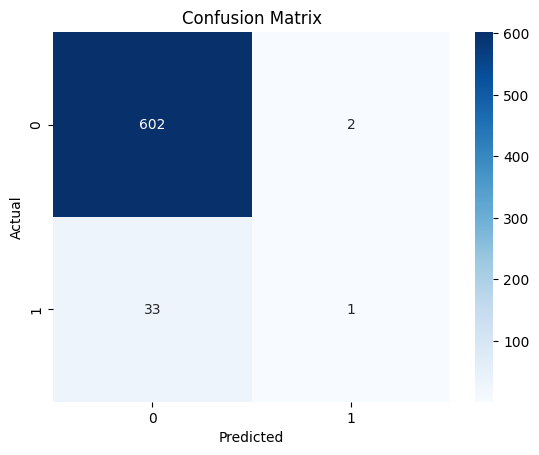

In [184]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [185]:
# Fermer la session Spark
spark.stop()